<a href="https://colab.research.google.com/github/manjuiitm/mlprojects/blob/main/House_price_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# In this notebook, I am going to perform EDA, Feature Engineering and Model Prediction for the Housing prices dataset



In [ ]:
!pip install kaggle


In [ ]:
from google.colab import files
files.upload()  # This will prompt you to upload the kaggle.json file

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"mrsmanju","key":"ffc202c5922a3f1d05fab536bfd3b7e9"}'}

In [ ]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/

mv: cannot stat 'kaggle.json': No such file or directory


In [ ]:
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
!kaggle datasets download -d rajarshiroy0123/house-prices-in-india-2023


Dataset URL: https://www.kaggle.com/datasets/rajarshiroy0123/house-prices-in-india-2023
License(s): CC0-1.0
  0% 0.00/1.55M [00:00<?, ?B/s]
100% 1.55M/1.55M [00:00<00:00, 117MB/s]


In [ ]:
!unzip house-prices-in-india-2023.zip


Archive:  house-prices-in-india-2023.zip
  inflating: Scraped_Data.csv        


In [ ]:
import pandas as pd
df = pd.read_csv('Scraped_Data.csv')

# Display the first few rows of the dataset
print(df.shape)


(27900, 91)


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import folium
from folium import  Marker
from folium.plugins import  MarkerCluster
import math


# In this Notebook, I would have 3 sub-tasks
1. Spliting the Main_dataset into 2 datasets 1 containing null values in the target value("exactPrice"), and other no containing null values
   
2. Copy the Main_dataset and droping all the null values , and do extensive data exploration on them.
   
3. Feature engineering, Feature selection and model building to build the prediction model. Test the model and apply to previously split data containing null "exactPrice"

Here I am converting 9 to NaN values in the dataframe


In [ ]:
df = df.replace("9",np.nan)
df.head()


,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,171,9,Multistorey Apartment,"Jun 20, '23",9.0,NaN,9,Danapur,Semi-Furnished,...,1,0,0,1,1,0,0,0,0,0
1,12000,12,12000,Multistorey Apartment,"Jun 19, '23",1.0,Monthly,1500,NaN,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
2,17000,7,9,Residential House,"Jun 21, '23",9.0,NaN,9,Phase 1 Ashiana Nagar,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
3,5000,9,9,Residential House,"Jun 23, '23",9.0,NaN,9,Kumhrar,Furnished,...,9,9,9,9,9,9,9,9,9,9
4,12000,9,24000,Multistorey Apartment,"Jun 24, '23",1.0,Monthly,500,Kumhrar,Unfurnished,...,9,9,9,9,9,9,9,9,9,9


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27900 entries, 0 to 27899
Data columns (total 91 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   exactPrice                            27900 non-null  int64  
 1   sqftPrice                             27900 non-null  int64  
 2   securityDeposit                       27900 non-null  int64  
 3   propertyType                          27888 non-null  object 
 4   postedOn                              27887 non-null  object 
 5   noOfLifts                             27445 non-null  float64
 6   maintenanceChargesFrequency           6594 non-null   object 
 7   maintenanceCharges                    27900 non-null  int64  
 8   locality                              25655 non-null  object 
 9   furnishing                            27221 non-null  object 
 10  flrNum                                21194 non-null  object 
 11  firstMonthCharg

In [ ]:
df["carpetAreaUnit"].value_counts()


,count
carpetAreaUnit,
Sq-ft,13399
Sq-yrd,981
Sq-m,634
Kanal,43
Marla,42
Biswa1,2
Rood,2
Biswa2,1
Acre,1


Since the Carpet area is having non consistent unit, We are going to change the carpet area to Sq-ft


In [ ]:
###Kanal carpet area in PAkistan multily by 5445
temp_dataset = df
selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Kanal"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Kanal"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Kanal

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Kanal"]), 'carpetArea'] = selected_rows['carpetArea'] * 5445

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Kanal"].head(5))

# -------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Sq-yrd"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-yrd"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Sq-yrd

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Sq-yrd"]), 'carpetArea'] = selected_rows['carpetArea'] * 9

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-yrd"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Sq-m"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-m"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Sq-m

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Sq-m"]), 'carpetArea'] = selected_rows['carpetArea'] * 10.7639

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Sq-m"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Marla"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Marla"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Marla used in Pakistan

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Marla"]), 'carpetArea'] = selected_rows['carpetArea'] * 272.251

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Marla"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Biswa1"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa1"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Biswa1 PAkistan,Bangladesh,India

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Biswa1"]), 'carpetArea'] = selected_rows['carpetArea'] * 1350

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa1"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Rood"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Rood"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Rood

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Rood"]), 'carpetArea'] = selected_rows['carpetArea'] * 272.25

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Rood"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Biswa2"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa2"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Biswa2

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Biswa2"]), 'carpetArea'] = selected_rows['carpetArea'] * 1350

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Biswa2"].head(5))

# ---------------

selected_rows = temp_dataset[temp_dataset['carpetAreaUnit'].isin(["Acre"])]
print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Acre"].head(5))

### MANIPULATING the values of carpetArea for the selected rows for Acre

temp_dataset.loc[temp_dataset['carpetAreaUnit'].isin(["Acre"]), 'carpetArea'] = selected_rows['carpetArea'] * 43560

print(temp_dataset["carpetArea"].loc[temp_dataset['carpetAreaUnit'] == "Acre"].head(5))

34      5445.0
49      5445.0
56     10890.0
69     21780.0
126     5445.0
Name: carpetArea, dtype: float64
34      29648025.0
49      29648025.0
56      59296050.0
69     118592100.0
126     29648025.0
Name: carpetArea, dtype: float64
65    1260.0
73    1530.0
75    1242.0
76    1080.0
77    1152.0
Name: carpetArea, dtype: float64
65    11340.0
73    13770.0
75    11178.0
76     9720.0
77    10368.0
Name: carpetArea, dtype: float64
728      602.7784
745     3552.0870
763      538.1950
990     2690.9750
1171    3552.0870
Name: carpetArea, dtype: float64
728      6488.246420
745     38234.309259
763      5793.077160
990     28965.385802
1171    38234.309259
Name: carpetArea, dtype: float64
60     3267.012
135    2178.008
160    2722.510
171    2722.510
266    2722.510
Name: carpetArea, dtype: float64
60     889447.284012
135    592964.856008
160    741206.070010
171    741206.070010
266    741206.070010
Name: carpetArea, dtype: float64
369      6750.0
25683    2700.0
Name: carpetArea, d

In [ ]:
df.shape


(27900, 91)

Since Every carpet area is converted into sq-ft unit, we don't need "carpetAreaUnit" anymore so we are dropping it


In [ ]:
df = df.drop(["carpetAreaUnit"],axis=1)


In [ ]:
df.shape

(27900, 90)

In [ ]:
features_with_na=[features for features in df.columns if df[features].isnull().sum()>1]

for feature in features_with_na:

    print(feature, np.round((df[feature].isnull().mean())*100, 4),  ' % missing values')


propertyType 0.043  % missing values
postedOn 0.0466  % missing values
noOfLifts 1.6308  % missing values
maintenanceChargesFrequency 76.3656  % missing values
locality 8.0466  % missing values
furnishing 2.4337  % missing values
flrNum 24.0358  % missing values
facing 52.448  % missing values
city 0.0466  % missing values
brokerage 79.2652  % missing values
URLs 0.1111  % missing values
RentOrSale 0.1111  % missing values


In [ ]:
df.columns


Index(['exactPrice', 'sqftPrice', 'securityDeposit', 'propertyType',
       'postedOn', 'noOfLifts', 'maintenanceChargesFrequency',
       'maintenanceCharges', 'locality', 'furnishing', 'flrNum',
       'firstMonthCharges', 'facing', 'totalFlrNum', 'city', 'carpetArea',
       'brokerage', 'bedrooms', 'bathrooms', 'balconies', 'Water_Storage',
       'Waste_Disposal', 'Visitor_Parking', 'Vaastu_Compliant', 'URLs',
       'Swimming_Pool', 'Skydeck', 'Service_Or_Goods_Lift', 'Security',
       'Retail_Boulevard___Retail_Shops__', 'Reserved_Parking',
       'Rentable_Community_Space', 'RentOrSale', 'Recreational_Pool',
       'Rain_Water_Harvesting', 'RO_Water_System', 'Private_Terrace_Or_Garden',
       'Private_Garden', 'Power_Back_Up', 'Piped_Gas', 'Park',
       'Outdoor_Tennis_Courts', 'Multipurpose_Hall', 'Multipurpose_Courts',
       'Mini_Cinema_Theatre', 'Meditation_Area', 'Maintenance_Staff', 'Long',
       'Lift', 'Library_And_Business_Centre', 'Library', 'Laundry_Service',
  

Since "exactPrice" is the target column and it has very low null value percentage, I am spliting the Main_dataset into two datasets:

1.   dataset : Containing Main_dataset where there are no Null values in "exactPrice" column

2.   data_null : Containing Main_dataset where there are Null values in "exactPrice" column



In [ ]:
df["exactPrice"].isnull().sum()

0

In [ ]:
data_null = df[df["exactPrice"].isnull() == True]


In [ ]:
data_null.shape


(0, 90)

In [ ]:
data_null.head()


,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM


In [ ]:
dataset = df.dropna(subset = ["exactPrice"])


In [ ]:
dataset.head()


,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,171,9,Multistorey Apartment,"Jun 20, '23",9.0,NaN,9,Danapur,Semi-Furnished,...,1,0,0,1,1,0,0,0,0,0
1,12000,12,12000,Multistorey Apartment,"Jun 19, '23",1.0,Monthly,1500,NaN,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
2,17000,7,9,Residential House,"Jun 21, '23",9.0,NaN,9,Phase 1 Ashiana Nagar,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
3,5000,9,9,Residential House,"Jun 23, '23",9.0,NaN,9,Kumhrar,Furnished,...,9,9,9,9,9,9,9,9,9,9
4,12000,9,24000,Multistorey Apartment,"Jun 24, '23",1.0,Monthly,500,Kumhrar,Unfurnished,...,9,9,9,9,9,9,9,9,9,9


## In Data Analysis We will Analyze To Find out the below stuff

1. Missing Values

2. All The Numerical Variables

3. Distribution of the Numerical Variables

4. Outliers

5. Categorical Variables

6. Cardinality of Categorical Variables

7. Mapping data as per their Longitude and Latitude


####Missing Values

In [ ]:
features_with_na=[features for features in dataset.columns if dataset[features].isnull().sum()>1]

for feature in features_with_na:

    print(feature, np.round((dataset[feature].isnull().mean())*100, 4),  ' % missing values\n')


propertyType 0.043  % missing values

postedOn 0.0466  % missing values

noOfLifts 1.6308  % missing values

maintenanceChargesFrequency 76.3656  % missing values

locality 8.0466  % missing values

furnishing 2.4337  % missing values

flrNum 24.0358  % missing values

facing 52.448  % missing values

city 0.0466  % missing values

brokerage 79.2652  % missing values

URLs 0.1111  % missing values

RentOrSale 0.1111  % missing values



#### Here we can clearly see the that most of the data is null in amenity featues , more than 78% , maintenanceCharges 76% and no of Lifts 1.63 %

##### We are droping all the null values to see the effect of the features on exact price

```
# This is formatted as code
```



In [ ]:
dataset


,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,171,9,Multistorey Apartment,"Jun 20, '23",9.0,NaN,9,Danapur,Semi-Furnished,...,1,0,0,1,1,0,0,0,0,0
1,12000,12,12000,Multistorey Apartment,"Jun 19, '23",1.0,Monthly,1500,NaN,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
2,17000,7,9,Residential House,"Jun 21, '23",9.0,NaN,9,Phase 1 Ashiana Nagar,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
3,5000,9,9,Residential House,"Jun 23, '23",9.0,NaN,9,Kumhrar,Furnished,...,9,9,9,9,9,9,9,9,9,9
4,12000,9,24000,Multistorey Apartment,"Jun 24, '23",1.0,Monthly,500,Kumhrar,Unfurnished,...,9,9,9,9,9,9,9,9,9,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27895,20227500,7500,9,Multistorey Apartment,"Jul 01, '23",2.0,Monthly,9,Dalanwala,Semi-Furnished,...,0,0,0,0,0,0,0,0,0,0
27896,6933500,4900,9,Multistorey Apartment,"Jun 30, '23",9.0,NaN,9,Canal Road,Semi-Furnished,...,0,0,0,0,0,0,0,0,0,0
27897,9000000,8182,9,Villa,"Jul 02, '23",9.0,NaN,9,Aman Vihar,Unfurnished,...,9,9,9,9,9,9,9,9,9,9
27898,7645000,5500,9,Multistorey Apartment,"Jul 01, '23",9.0,NaN,9,Sahastradhara Road,Unfurnished,...,0,0,0,1,0,0,0,0,0,0


In [ ]:
dataset_dropped_na = dataset.dropna().copy()

In [ ]:
dataset_dropped_na

,exactPrice,sqftPrice,securityDeposit,propertyType,postedOn,noOfLifts,maintenanceChargesFrequency,maintenanceCharges,locality,furnishing,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
24,27000,11,27000,Builder Floor Apartment,"May 08, '23",9.0,Monthly,500,Sector 19,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
26,135000,27,270000,Residential House,"May 08, '23",9.0,Monthly,1000,Sector 18,Unfurnished,...,9,9,9,9,9,9,9,9,9,9
28,55000,11,55000,Builder Floor Apartment,"May 23, '23",9.0,Monthly,500,Sector-35,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
29,40000,16,40000,Builder Floor Apartment,"May 17, '23",9.0,Monthly,500,Sector 20,Furnished,...,9,9,9,9,9,9,9,9,9,9
30,75000,15,75000,Residential House,"May 17, '23",9.0,Monthly,500,Sector 19,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27858,9000000,84905,9,Residential House,"May 30, '23",9.0,Monthly,9,Doon IT Park,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
27880,12500000,4545,9,Residential House,"Jul 02, '23",9.0,Monthly,9,Sahastradhara Road,Semi-Furnished,...,9,9,9,9,9,9,9,9,9,9
27884,25000000,10204,9,Multistorey Apartment,"Jul 02, '23",2.0,Monthly,9,Sahastradhara Road,Semi-Furnished,...,0,0,0,0,1,0,0,0,0,0
27895,20227500,7500,9,Multistorey Apartment,"Jul 01, '23",2.0,Monthly,9,Dalanwala,Semi-Furnished,...,0,0,0,0,0,0,0,0,0,0


#### A huge chunk of the data set is removed because of dropping null values, Lets explore this dataset 1st

### 2. All The Numerical Variables


In [ ]:
# list of numerical variables
numerical_features = [feature for feature in dataset_dropped_na.columns if dataset_dropped_na[feature].dtypes != 'O']

print('Number of numerical variables: ', len(numerical_features))

# visualise the numerical variables
dataset_dropped_na[numerical_features].head()

Number of numerical variables:  79


,exactPrice,sqftPrice,securityDeposit,noOfLifts,maintenanceCharges,firstMonthCharges,totalFlrNum,carpetArea,bedrooms,bathrooms,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
24,27000,11,27000,9.0,500,68000,2,1500.0,3,2,...,9,9,9,9,9,9,9,9,9,9
26,135000,27,270000,9.0,1000,473500,2,2500.0,3,3,...,9,9,9,9,9,9,9,9,9,9
28,55000,11,55000,9.0,500,138000,2,2200.0,3,3,...,9,9,9,9,9,9,9,9,9,9
29,40000,16,40000,9.0,500,100500,2,1600.0,3,2,...,9,9,9,9,9,9,9,9,9,9
30,75000,15,75000,9.0,500,188000,2,2500.0,3,3,...,9,9,9,9,9,9,9,9,9,9


In [ ]:
## Numerical variables are usually of 2 type
## 1. Continous variable and Discrete Variables

discrete_feature=[feature for feature in numerical_features if len(dataset_dropped_na[feature].unique())<25 and feature]
print("Discrete Variables Count: {}".format(len(discrete_feature)))


Discrete Variables Count: 70


In [ ]:
#  We are left with only houses for rent after dropping the null values
#  It proves that only 1530 out of 279000 properties have the information about all the features. i.e. 0.11% ,very rare

dataset_dropped_na["RentOrSale"].value_counts()

,count
RentOrSale,
Rent,1530
Sale,1219


In [ ]:
dataset_dropped_na[discrete_feature].head()


,noOfLifts,bedrooms,bathrooms,balconies,Water_Storage,Waste_Disposal,Visitor_Parking,Vaastu_Compliant,Swimming_Pool,Skydeck,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
24,9.0,3,2,2,9,9,9,9,9,9,...,9,9,9,9,9,9,9,9,9,9
26,9.0,3,3,2,9,9,9,9,9,9,...,9,9,9,9,9,9,9,9,9,9
28,9.0,3,3,2,9,9,9,9,9,9,...,9,9,9,9,9,9,9,9,9,9
29,9.0,3,2,2,9,9,9,9,9,9,...,9,9,9,9,9,9,9,9,9,9
30,9.0,3,3,2,9,9,9,9,9,9,...,9,9,9,9,9,9,9,9,9,9


### 3. Distribution of the Numerical Variables

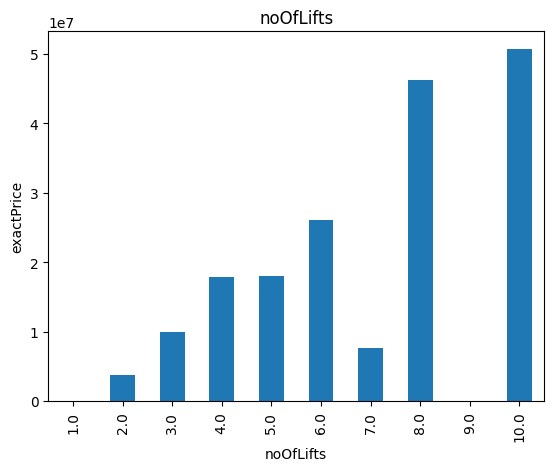

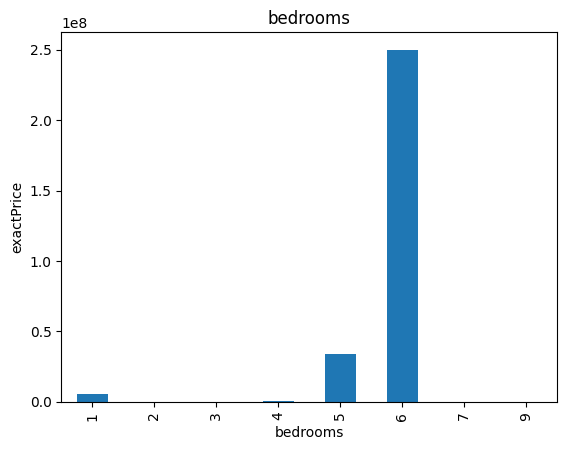

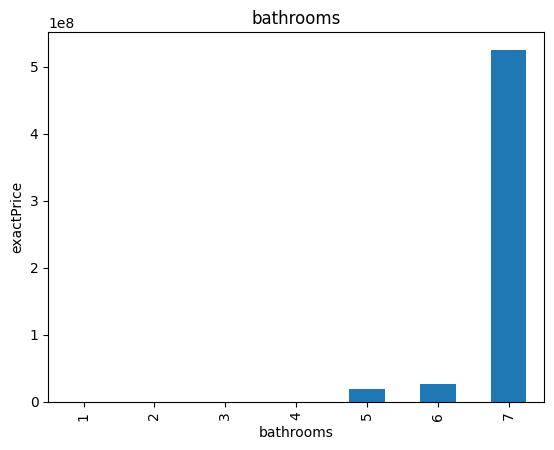

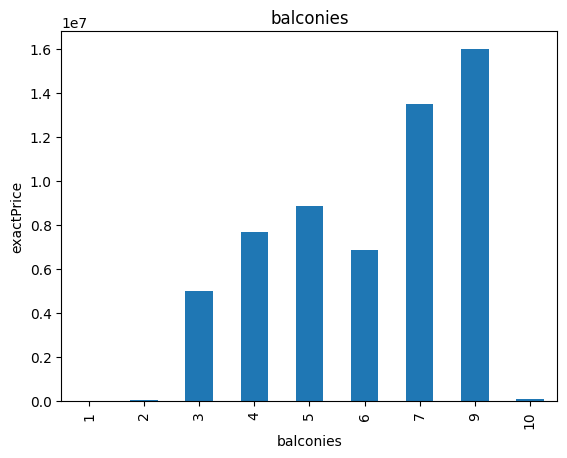

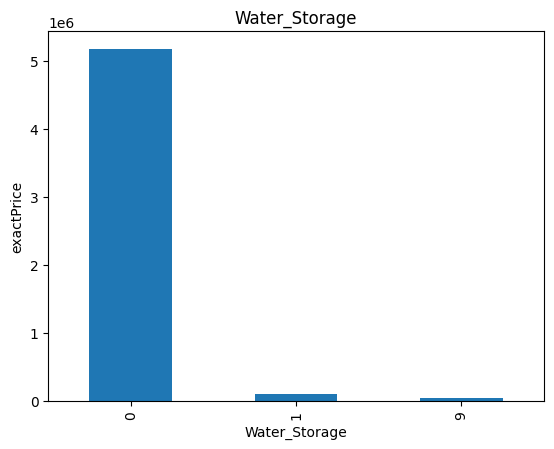

...

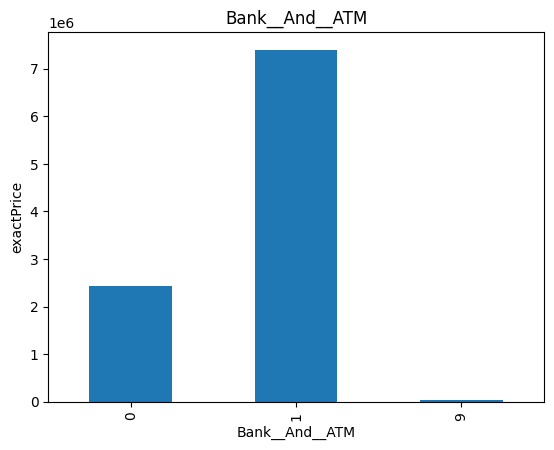

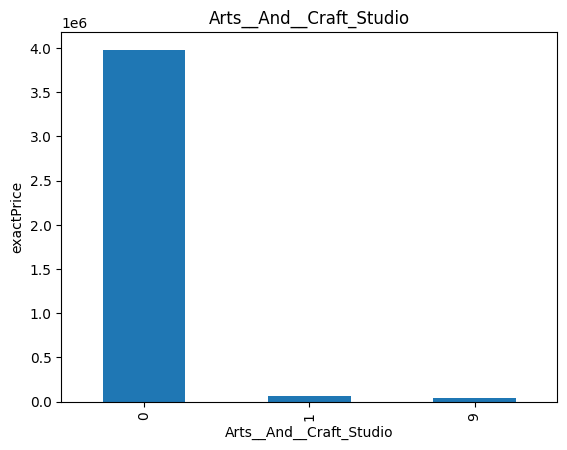

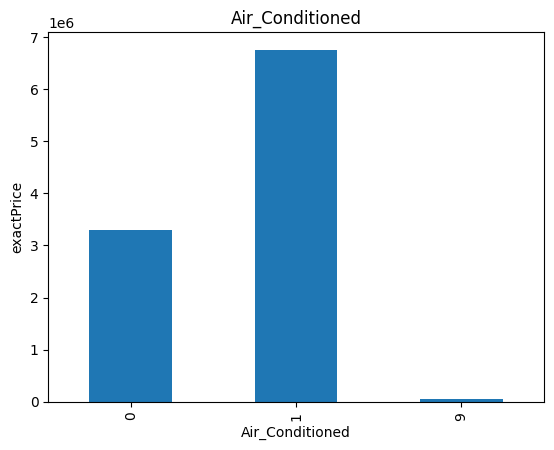

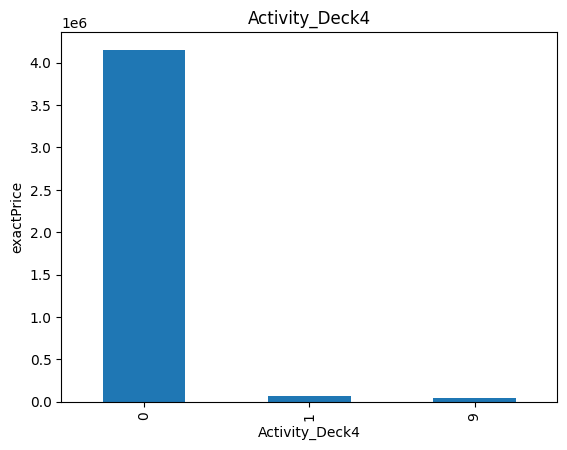

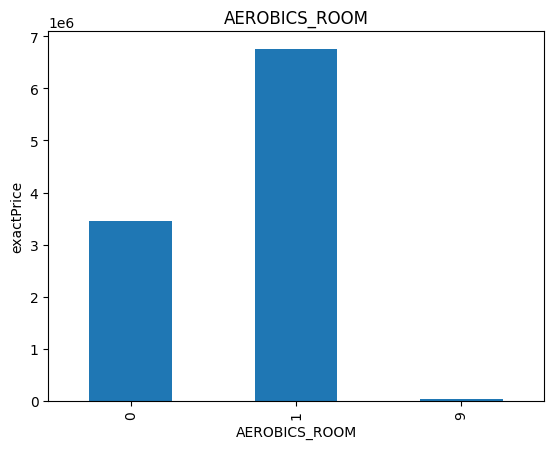

In [ ]:
for feature in discrete_feature:
    data=dataset_dropped_na.copy()
    dataset_dropped_na.groupby(feature)['exactPrice'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('exactPrice')
    plt.title(feature)
    plt.show()

In [ ]:
### Continuous Variable
continuous_feature=[feature for feature in numerical_features if feature not in discrete_feature]
print("Continuous feature Count {}".format(len(continuous_feature)))


Continuous feature Count 9


In [ ]:
#  Removing Latitude and Longitude since their main significance is to explore data based on geolocation
continuous_feature.remove("Lat")
continuous_feature.remove("Long")

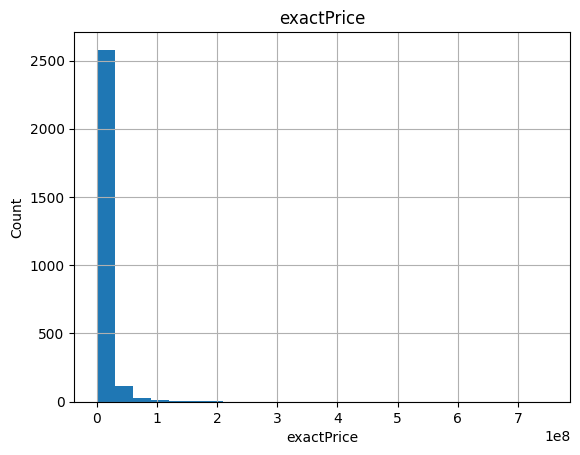

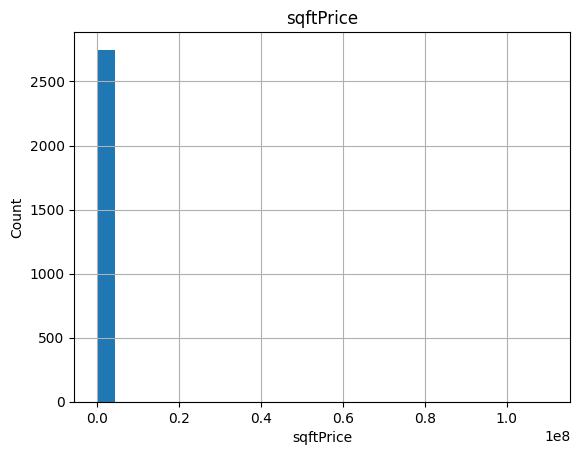

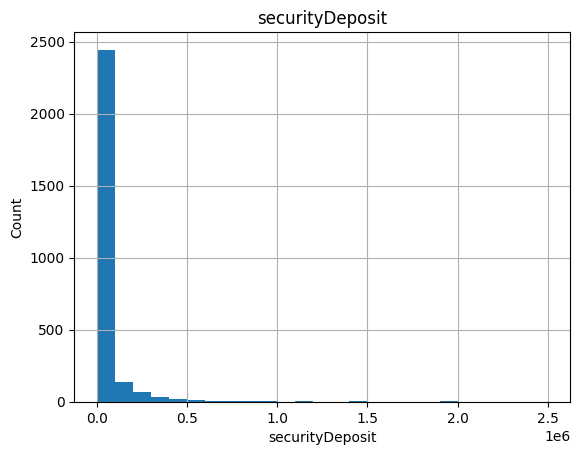

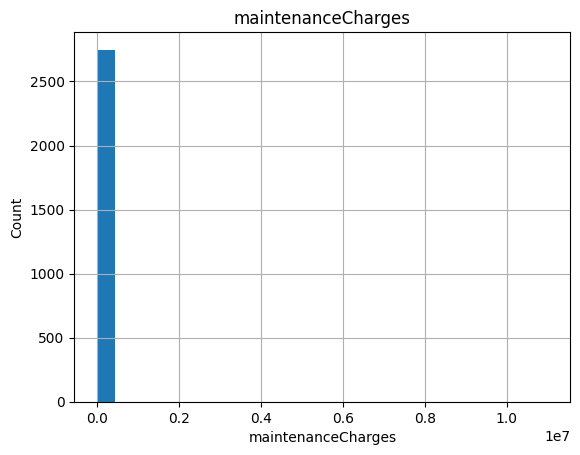

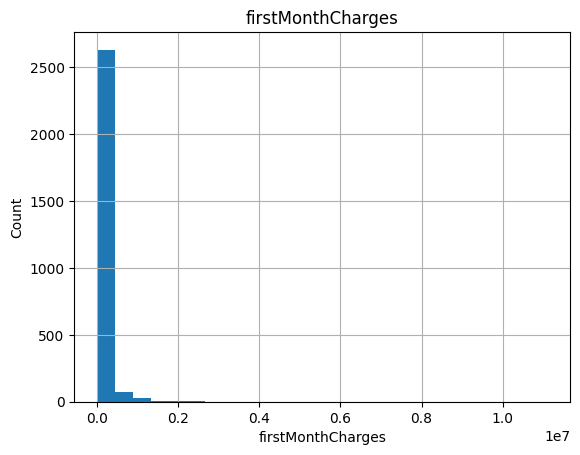

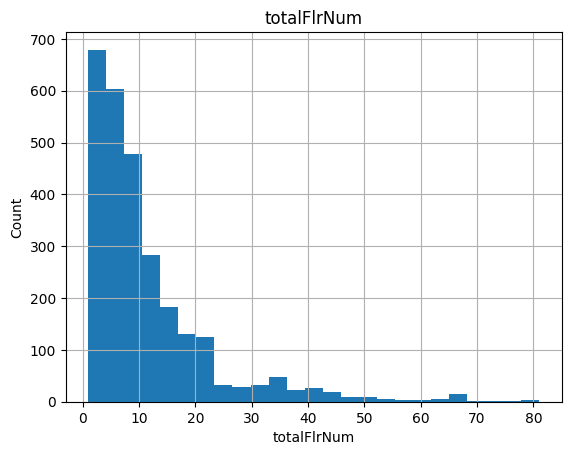

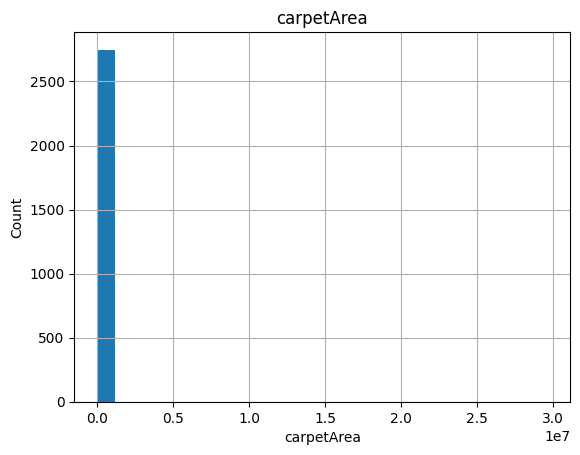

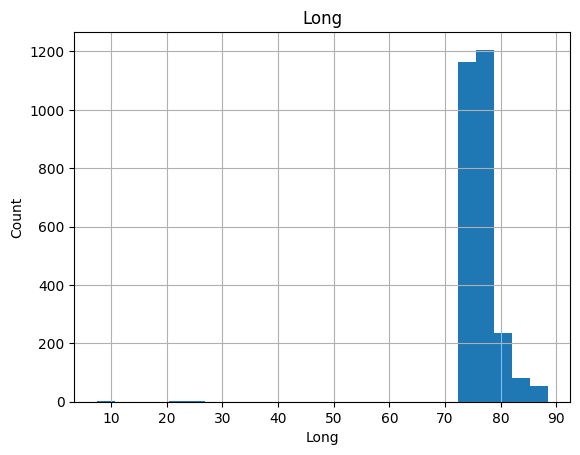

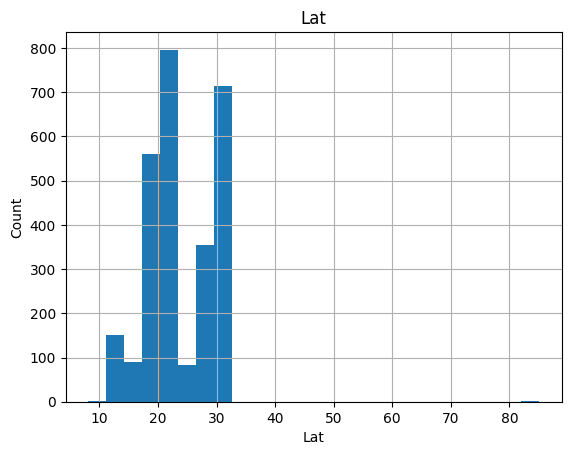

In [ ]:
## Lets analyse the continuous values by creating histograms to understand the distribution

for feature in continuous_feature:
    data=dataset_dropped_na.copy()
    dataset_dropped_na[feature].hist(bins=25)
    plt.xlabel(feature)
    plt.ylabel("Count")
    plt.title(feature)
    plt.show()

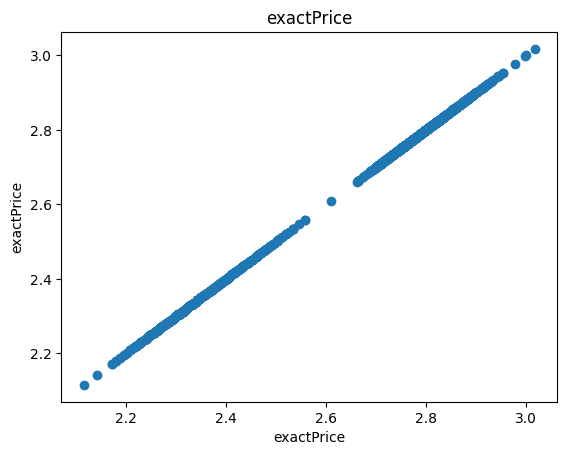

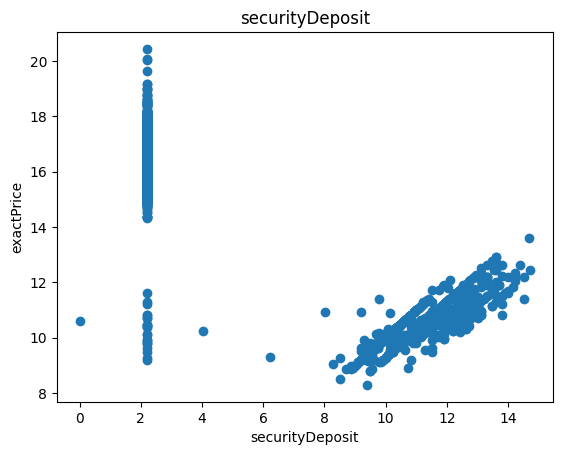

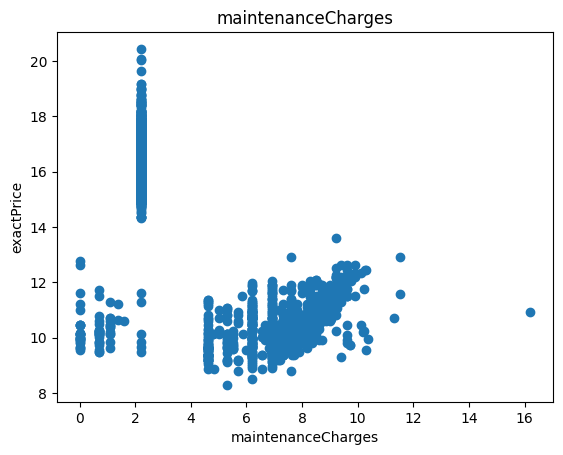

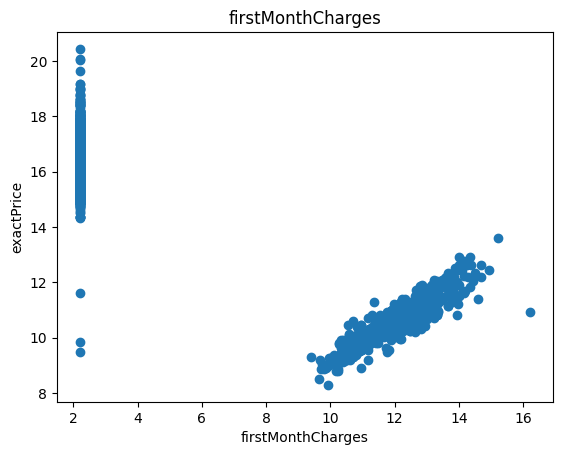

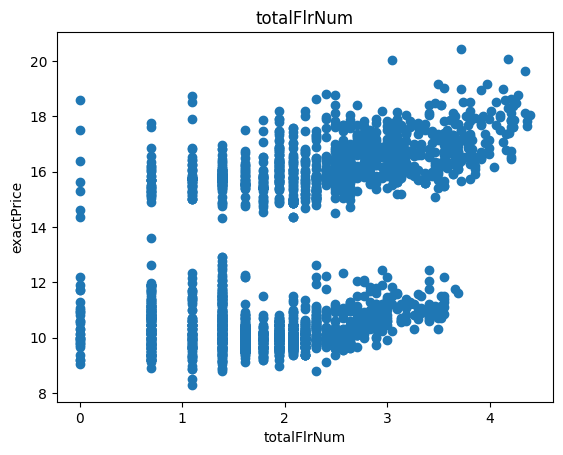

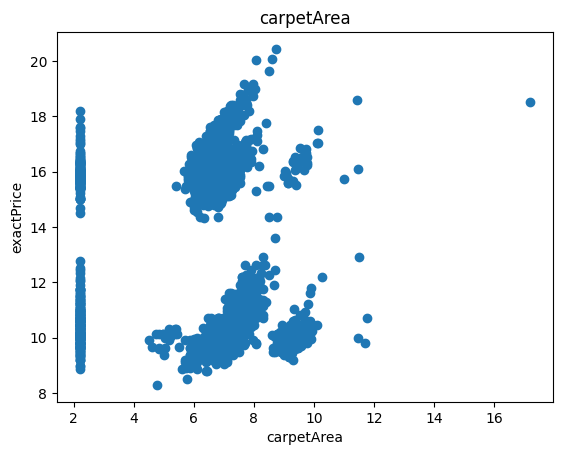

In [ ]:
## We will be using logarithmic transformation


for feature in continuous_feature:
    data=dataset_dropped_na.copy()
    if 0 in data[feature].unique():
        pass
    else:
        data[feature]=np.log(data[feature])
        data['exactPrice']=np.log(data['exactPrice'])
        plt.scatter(data[feature],data['exactPrice'])
        plt.xlabel(feature)
        plt.ylabel('exactPrice')
        plt.title(feature)
        plt.show()

### 4. Outliers

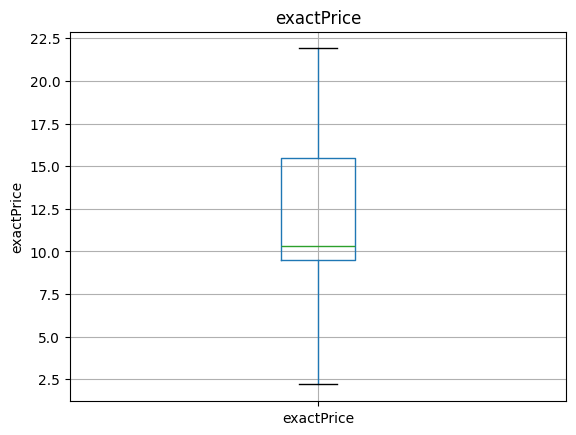

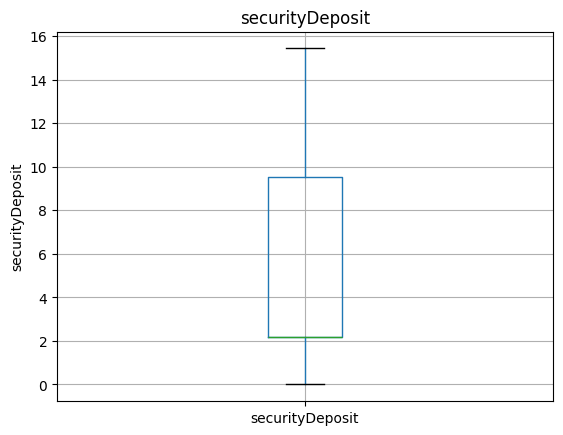

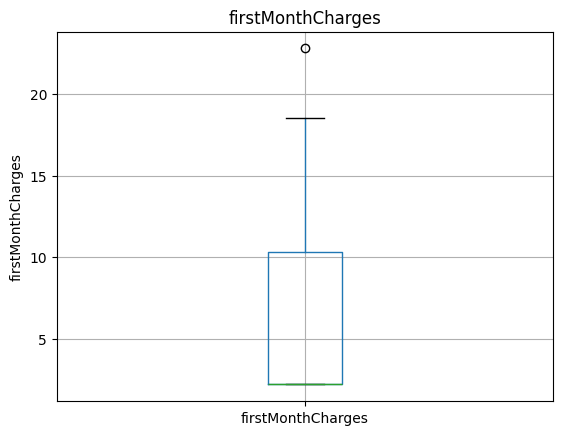

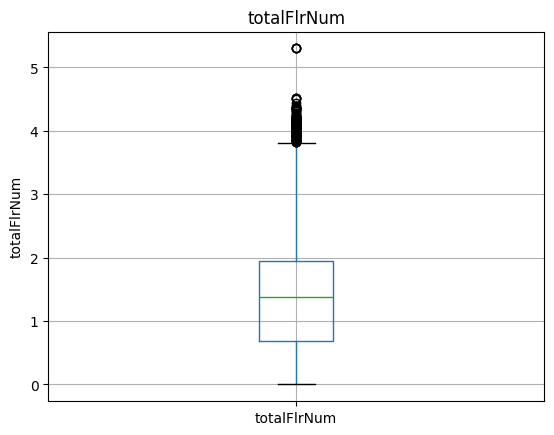

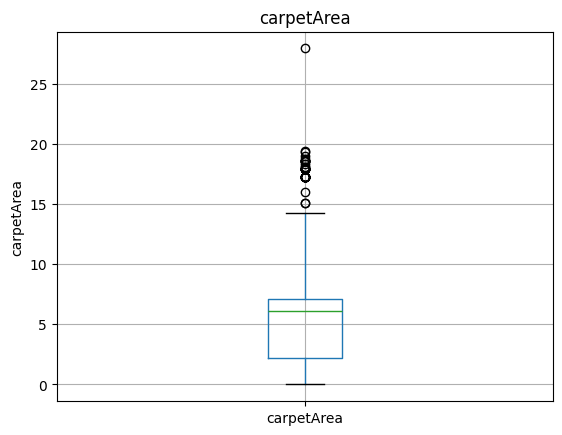

In [ ]:
for feature in continuous_feature:
    data=dataset.copy()
    if 0 in data[feature].unique():
        pass
    else:
        data[feature]=np.log(data[feature])
        data.boxplot(column=feature)
        plt.ylabel(feature)
        plt.title(feature)
        plt.show()

### 5. Categorical Variables

In [ ]:
categorical_features=[feature for feature in dataset_dropped_na.columns if dataset_dropped_na[feature].dtypes=='O']
categorical_features

['propertyType',
 'postedOn',
 'maintenanceChargesFrequency',
 'locality',
 'furnishing',
 'flrNum',
 'facing',
 'city',
 'brokerage',
 'URLs',
 'RentOrSale']

In [ ]:
dataset_dropped_na[categorical_features].head()

,propertyType,postedOn,maintenanceChargesFrequency,locality,furnishing,flrNum,facing,city,brokerage,URLs,RentOrSale
24,Builder Floor Apartment,"May 08, '23",Monthly,Sector 19,Semi-Furnished,1,North,Chandigarh,15 days,https://www.magicbricks.com/propertyDetails/3-...,Rent
26,Residential House,"May 08, '23",Monthly,Sector 18,Unfurnished,1,North - East,Chandigarh,15 days,https://www.magicbricks.com/propertyDetails/3-...,Rent
28,Builder Floor Apartment,"May 23, '23",Monthly,Sector-35,Semi-Furnished,1,North,Chandigarh,15 days,https://www.magicbricks.com/propertyDetails/3-...,Rent
29,Builder Floor Apartment,"May 17, '23",Monthly,Sector 20,Furnished,2,North,Chandigarh,15 days,https://www.magicbricks.com/propertyDetails/3-...,Rent
30,Residential House,"May 17, '23",Monthly,Sector 19,Semi-Furnished,1,North,Chandigarh,15 days,https://www.magicbricks.com/propertyDetails/3-...,Rent


In [ ]:
for feature in categorical_features:
    print('The feature is {} and number of categories are {}'.format(feature,len(dataset_dropped_na[feature].unique())))

The feature is propertyType and number of categories are 5
The feature is postedOn and number of categories are 64
The feature is maintenanceChargesFrequency and number of categories are 5
The feature is locality and number of categories are 665
The feature is furnishing and number of categories are 3
The feature is flrNum and number of categories are 53
The feature is facing and number of categories are 8
The feature is city and number of categories are 15
The feature is brokerage and number of categories are 16
The feature is URLs and number of categories are 2749
The feature is RentOrSale and number of categories are 2


ou are removing certain features from the categorical_features list for specific reasons, likely based on your analysis of their characteristics or their relevance to your current exploration. Let me explain why you might want to remove each feature:

postedOn (54 categories):

This feature likely represents the date or timestamp when a property was posted. Dates are typically not useful as categorical features for modeling purposes, especially if you don't plan to analyze them as time-series data. Instead, you may want to convert them into more meaningful features like the day of the week, month, or year if relevant.
locality (114 categories):

Locality represents the area or neighborhood where the property is located, and it seems to have a large number of categories (114). High cardinality (many categories) can lead to sparsity in the data, and encoding such a feature as categorical might result in a high-dimensional feature that is not useful or might make it harder for models to generalize effectively. In some cases, this feature might be dropped or transformed (e.g., by grouping neighborhoods into broader regions).
URLs (362 categories):

This feature most likely represents URLs or web links to individual property listings. Since each listing's URL is unique, this feature will have a high cardinality, and using it as a categorical feature wouldn't make sense. It does not provide meaningful information for analysis or modeling, so it's better to remove it from the list.
RentOrSale (1 category):

This feature contains only a single category (either "Rent" or "Sale"). If there's only one unique value, it doesn't provide any useful variation or information, so it doesn't contribute to the model. Removing it makes sense to avoid introducing unnecessary noise.
Summary
You're removing these features because:

postedOn: likely needs to be treated as a date-time feature, not a categorical one.
locality: has high cardinality and might require special handling or grouping.
URLs: doesn't provide useful information for the model due to its uniqueness.
RentOrSale: has only one unique value, making it redundant.
These removals help streamline your analysis and modeling process by eliminating features that won't contribute meaningfully.

In [ ]:
### 6. Cardinality of Categorical Variables

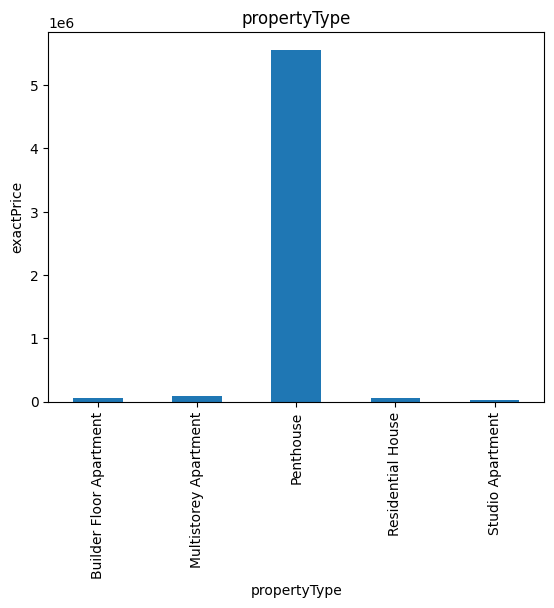

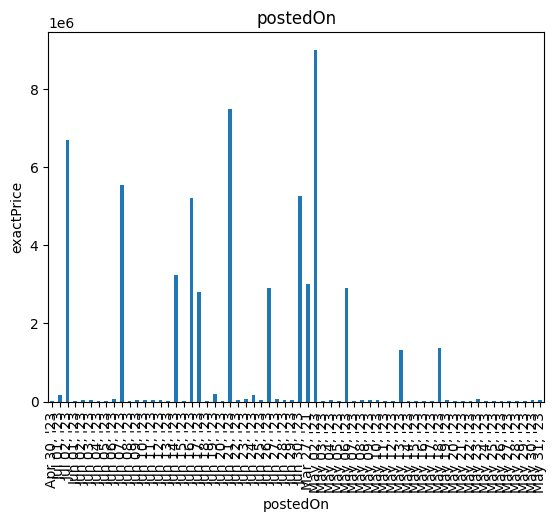

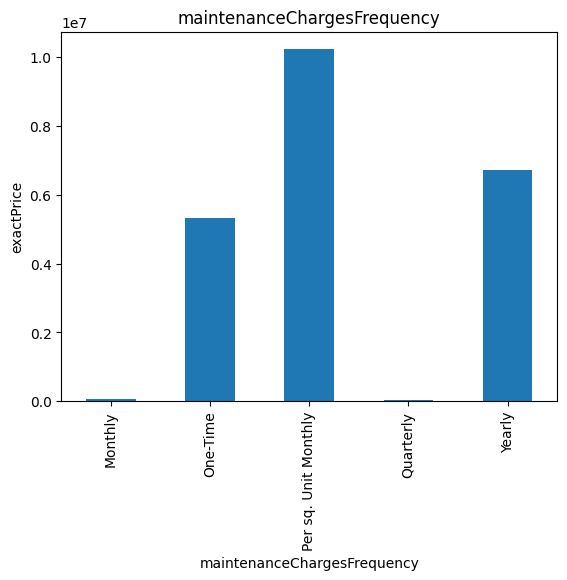

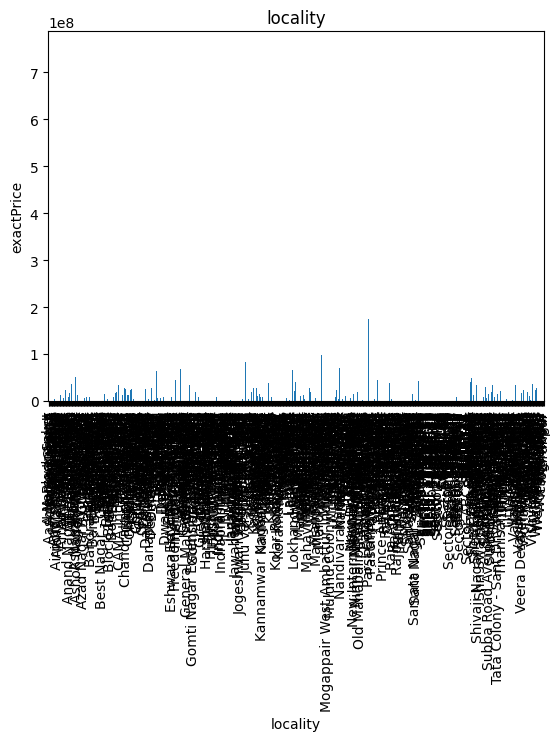

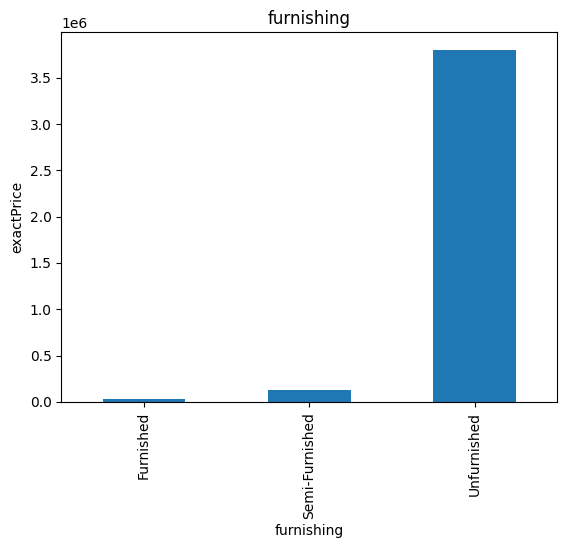

...

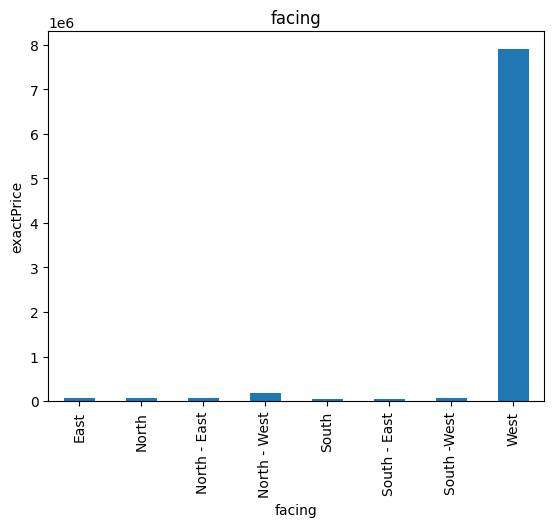

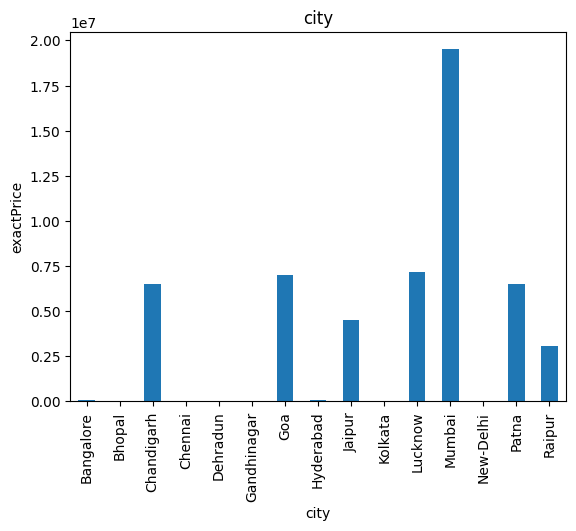

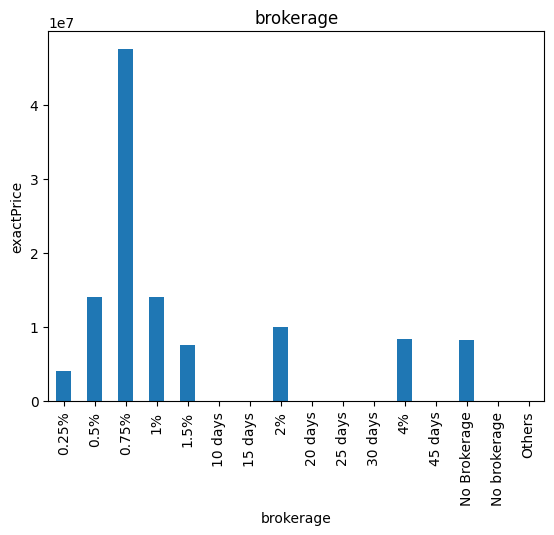

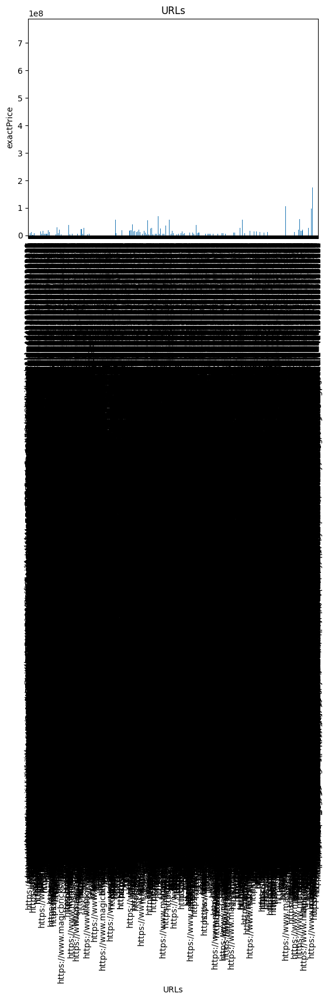

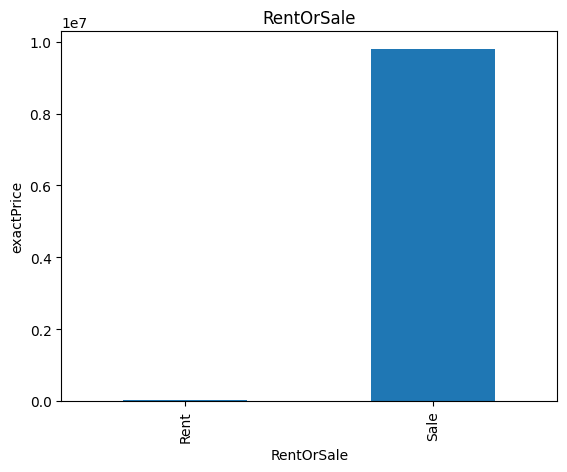

In [ ]:
for feature in categorical_features:
    data=dataset_dropped_na.copy()
    data.groupby(feature)['exactPrice'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('exactPrice')
    plt.title(feature)
    plt.show()

### 7. Mapping data as per their Longitude and Latitude

In [ ]:
def preprocess_for_map(df) :
    df = df[['locality','Lat','Long','exactPrice',"city"]]
    # df = df.replace('NA', np.nan)
    df.dropna(subset=['Lat'], inplace=True)
    df.dropna(subset=['exactPrice'], inplace=True)
    df["Lat"] = df["Lat"].astype(float)
    df["Long"] = df["Long"].astype(float)
    return df


map_data = preprocess_for_map(dataset)

<ipython-input-41-264d7b21176a>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(subset=['Lat'], inplace=True)
<ipython-input-41-264d7b21176a>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.dropna(subset=['exactPrice'], inplace=True)
<ipython-input-41-264d7b21176a>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Lat"] = df["Lat"].astype(float)
<ipython-input-4

In [ ]:
map_data[['Lat','Long','exactPrice',"city"]]

,Lat,Long,exactPrice,city
0,25.605898,85.056330,240000,Patna
1,9.000000,9.000000,12000,Patna
2,25.621426,85.079964,17000,Patna
3,25.593090,85.185006,5000,Patna
4,25.593090,85.185005,12000,Patna
...,...,...,...,...
27895,30.314961,78.056634,20227500,Dehradun
27896,30.370890,78.081697,6933500,Dehradun
27897,30.354673,78.077240,9000000,Dehradun
27898,30.354086,78.082277,7645000,Dehradun


In [ ]:
city_map = folium.Map(location=[21, 78], zoom_start=11.2,
                      tiles='Stamen Terrain',
                      attr='Map tiles by Stamen Design, under CC BY 3.0. Data by OpenStreetMap, under ODbL.')
mc = MarkerCluster()
for idx, row in map_data.iterrows():
    if not math.isnan(row['Long']) and not math.isnan(row['Lat']):
        popup = """
        Locality : <b>%s</b><br>
        Price : <b>%s</b><br>
        city : <b>%s</b><br>
        """ % (row['locality'], row['exactPrice'],row["city"])
        mc.add_child(Marker([row['Lat'], row['Long']],tooltip=popup))
    city_map.add_child(mc)
city_map

# Initiation of Step 3


### Uptil now we have explored data with no null value in all the 90 features. But this resulted into very low amount of data to explore
##### Now we are going to choose specific columns to drop the null values and for important features we would fill the null values to explore wider rande of data
##### Since the exactPrice of properties for Sale would be very high than that of rent, I am seperating the the dataset on rent or sale to get a better look in the characteristics of the features

In [ ]:
### Since Rent or Sale feature has very low null values 0.11%, I have decided to drop it from features_with_na and drop null values in dataset for smoother analysis
### Removing from features_with_na list

features_with_na.remove("RentOrSale")
features_with_na.remove("URLs")

### dropiing the features from the dataset

dataset = dataset.dropna(subset = ["RentOrSale"])
dataset = dataset.dropna(subset = ["URLs"])

#### Making an empty set to append all the important features/ those features where Null values scored more than the not Null values, Since those features are important and should not be droped the null values right away

#### Initializing a set of important features

In [ ]:
impFea =set()

In [ ]:
type(impFea)

set

### Here we check If the null values in any any feature correlates to higher exactPrice and store them in a set for further analysis

propertyType 0.04  % missing values


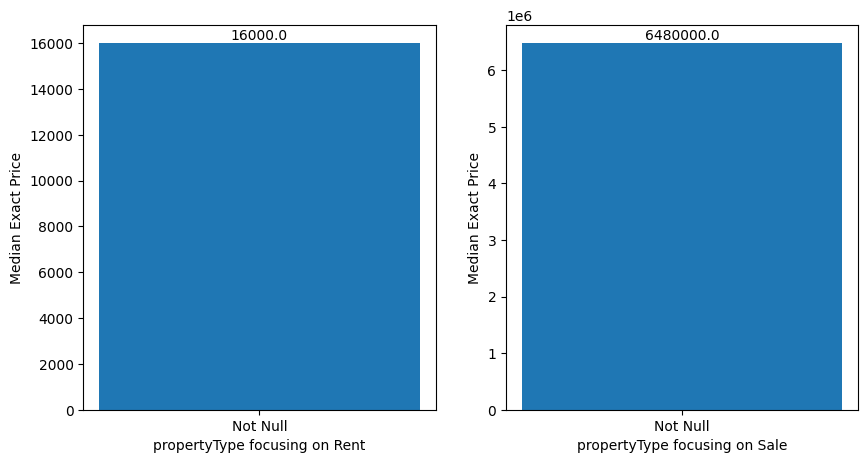

postedOn 0.05  % missing values


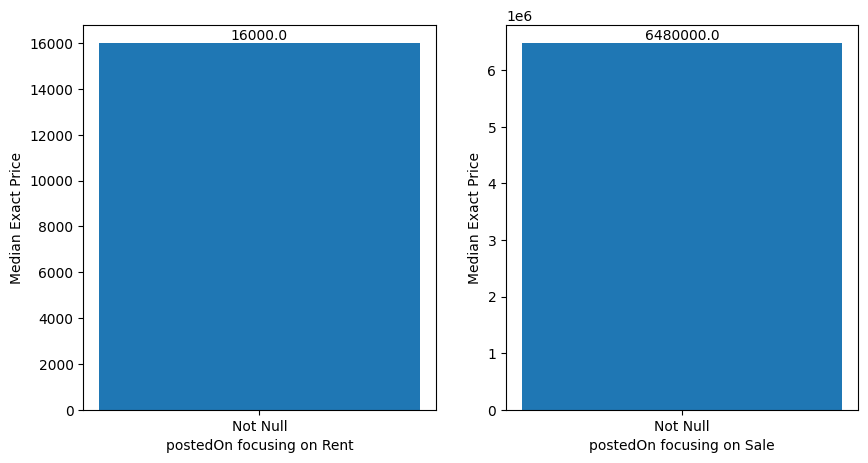

noOfLifts 1.63  % missing values


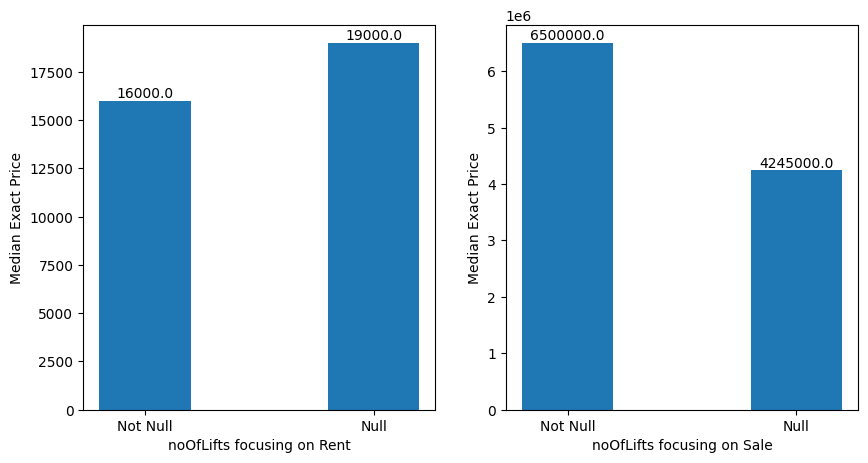

maintenanceChargesFrequency 76.37  % missing values


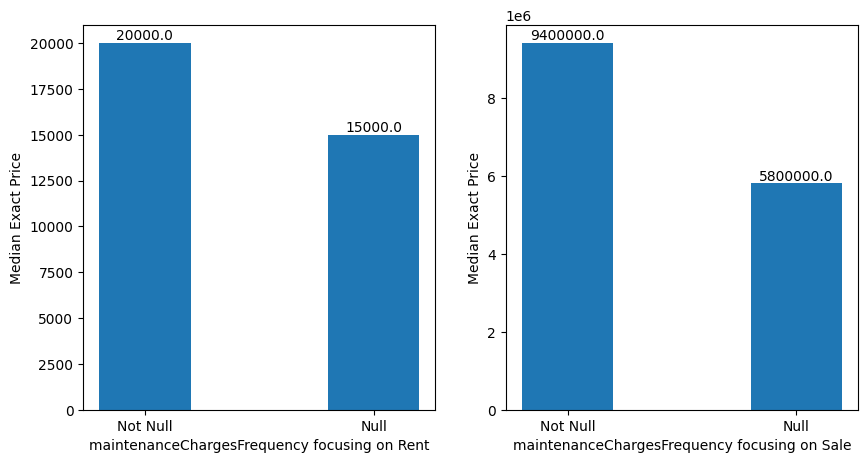

locality 8.05  % missing values


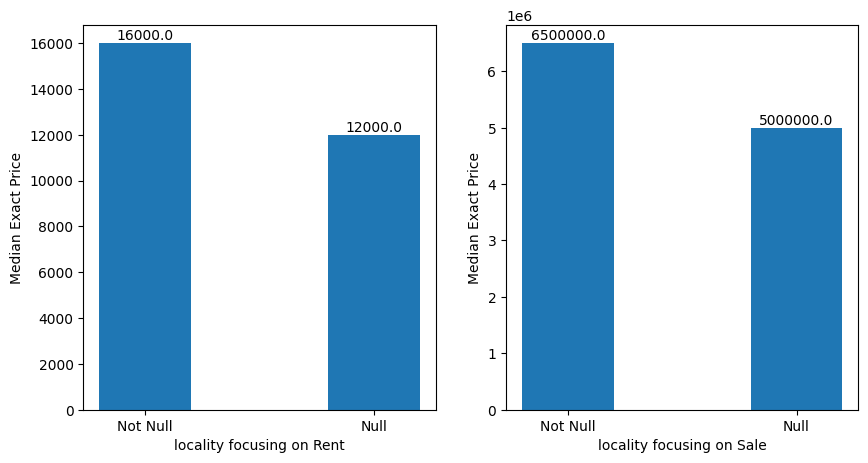

furnishing 2.4299999999999997  % missing values


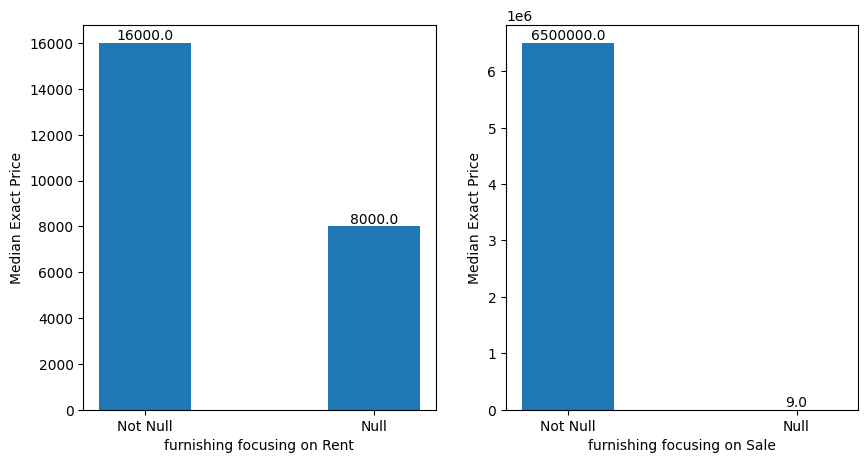

flrNum 24.04  % missing values


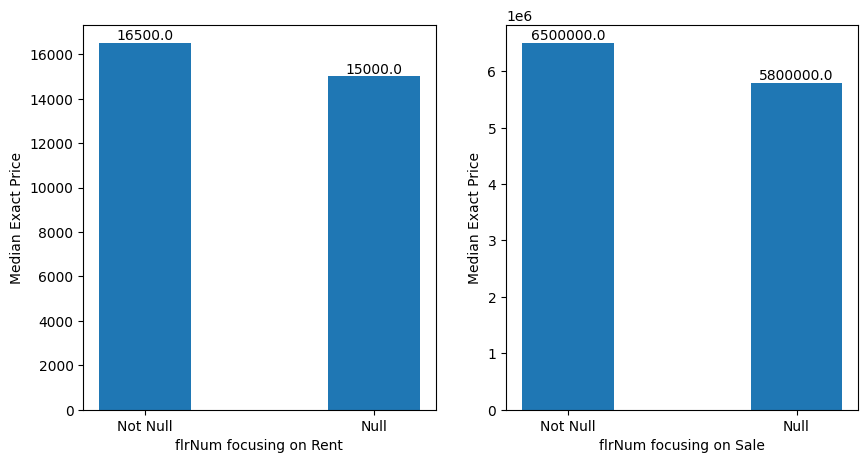

facing 52.449999999999996  % missing values


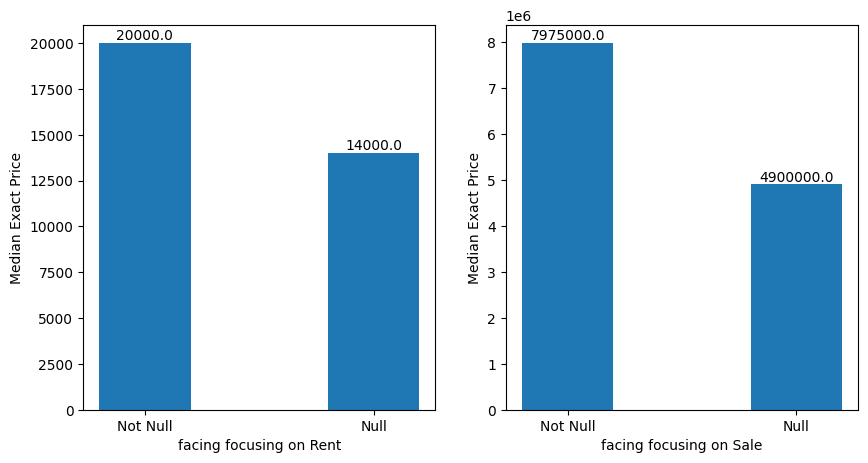

city 0.05  % missing values


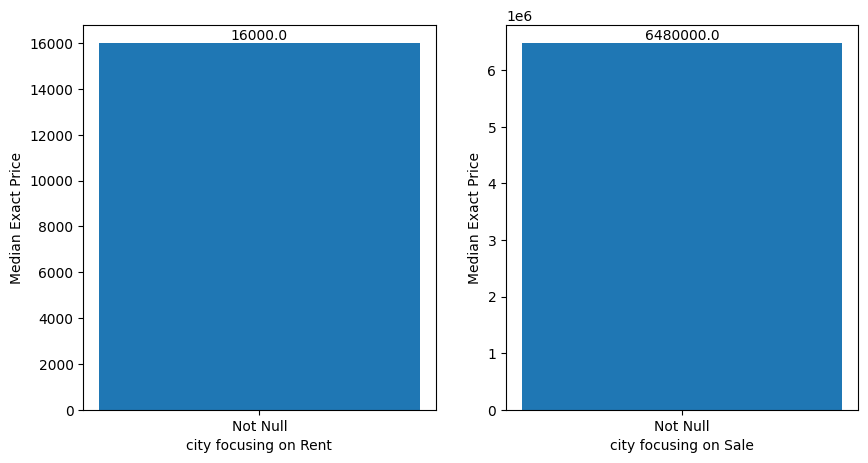

brokerage 79.27  % missing values


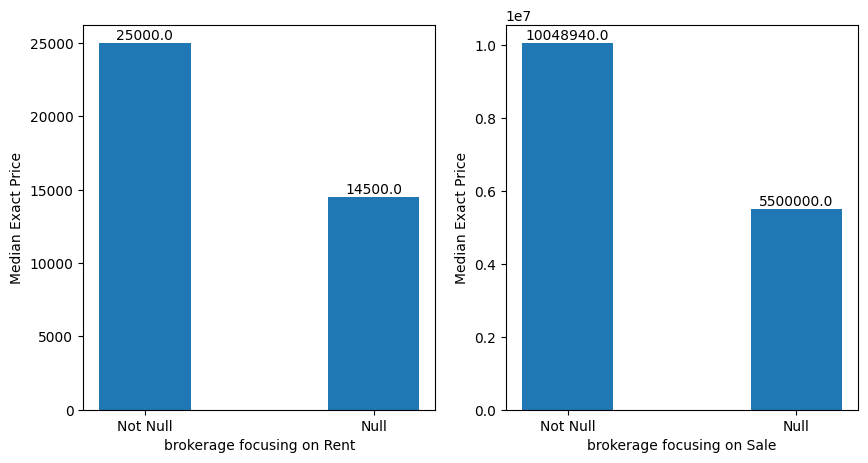

In [ ]:
for feature in features_with_na:
    data = dataset.copy()

    data[feature] = np.where(data[feature].isnull(), 1, 0)
    print(feature, (np.round(df[feature].isnull().mean(), 4)*100),  ' % missing values')

    bar_width = 0.4
    # grouped_data = data.groupby(feature)['exactPrice'].median()

    # Create a multibar plot
    category_data_rent = data[data['RentOrSale'] == "Rent"]

    category_data_sale = data[data['RentOrSale'] == "Sale"]

    dict = {0 :"Not Null", 1 :"Null"}

    def keys(x):
        key = dict[x]
        return key

    ### Rent subplot
    plt.figure(figsize = (10,5))
    plt.subplot(1,2,1)
    median_values = category_data_rent.groupby(feature)['exactPrice'].median()

    # since here 0 represents Not Null values and 1 represents Null values
    LIST = list(median_values.index)
    x = list(map(keys,LIST))

    if len(x) == 1:
        bar_width = 4
        if x == ["Null"]:
            impFea.add(feature)
    else:
         if median_values[1] > median_values[0]:
              impFea.add(feature)

    plt.bar(x, median_values, width=bar_width, label="Rent")

    for i,val in enumerate(LIST):
        plt.text(val,median_values[val],median_values[val],ha = "center", va = "bottom")

    str = f"{feature} focusing on Rent"
    plt.xlabel(str)
    plt.ylabel('Median Exact Price')


    ### Sale subplot
    plt.subplot(1,2,2)
    bar_width = 0.4
    median_values = category_data_sale.groupby(feature)['exactPrice'].median()

    # since here 0 represents Not Null values and 1 represents Null values
    LIST = list(median_values.index)
    x = list(map(keys,LIST))

    if len(x) == 1:
        bar_width = 4
        if x == ["Null"]:
            impFea.add(feature)


    else:
         if median_values[1] > median_values[0]:
              impFea.add(feature)

    plt.bar(x, median_values, width=bar_width, label="Sale")


    for i,val in enumerate(LIST):
        plt.text(val,median_values[val],median_values[val],ha = "center", va = "bottom")

    str = f"{feature} focusing on Sale"
    plt.xlabel(str)
    plt.ylabel('Median Exact Price')



    # Show the plot
    plt.show()


In [ ]:
#  We got the important features
impFea

{'noOfLifts'}

In [ ]:
#### Using the postedOn feature to make new feature postedOn_DaysAgo, to represent how long ago the property was poster on the website
import datetime

# date_string = "Jun 20, '23"
def date_transform(date):

    date_object = datetime.datetime.strptime(date, "%b %d, '%y")
    formatted_date = datetime.datetime.strftime(date_object,"%Y-%m-%d")
    new_date = datetime.datetime.strptime(formatted_date, "%Y-%m-%d").date()


    current_date = datetime.date.today()
    ab = (current_date - new_date).days
    return ab


date_transform(dataset["postedOn"][10])

557

In [ ]:
dataset["postedOn_DaysAgo"] = dataset["postedOn"].apply(date_transform)

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27869 entries, 0 to 27899
Data columns (total 91 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   exactPrice                            27869 non-null  int64  
 1   sqftPrice                             27869 non-null  int64  
 2   securityDeposit                       27869 non-null  int64  
 3   propertyType                          27869 non-null  object 
 4   postedOn                              27869 non-null  object 
 5   noOfLifts                             27414 non-null  float64
 6   maintenanceChargesFrequency           6590 non-null   object 
 7   maintenanceCharges                    27869 non-null  int64  
 8   locality                              25641 non-null  object 
 9   furnishing                            27204 non-null  object 
 10  flrNum                                21178 non-null  object 
 11  firstMonthCharges   

### Filling the null values with  missing for important features

In [ ]:
dataset[list(impFea)] = dataset[list(impFea)].fillna(value = "Missing")

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 27869 entries, 0 to 27899
Data columns (total 91 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   exactPrice                            27869 non-null  int64  
 1   sqftPrice                             27869 non-null  int64  
 2   securityDeposit                       27869 non-null  int64  
 3   propertyType                          27869 non-null  object 
 4   postedOn                              27869 non-null  object 
 5   noOfLifts                             27869 non-null  object 
 6   maintenanceChargesFrequency           6590 non-null   object 
 7   maintenanceCharges                    27869 non-null  int64  
 8   locality                              25641 non-null  object 
 9   furnishing                            27204 non-null  object 
 10  flrNum                                21178 non-null  object 
 11  firstMonthCharges   

In [ ]:
features_with_na=[features for features in dataset.columns if dataset[features].isnull().sum()>1]

for feature in features_with_na:

    print(feature, np.round((dataset[feature].isnull().mean())*100, 4),  ' % missing values\n')

propertyType 0.043  % missing values

postedOn 0.0466  % missing values

noOfLifts 1.6308  % missing values

maintenanceChargesFrequency 76.3656  % missing values

locality 8.0466  % missing values

furnishing 2.4337  % missing values

flrNum 24.0358  % missing values

facing 52.448  % missing values

city 0.0466  % missing values

brokerage 79.2652  % missing values

URLs 0.1111  % missing values

RentOrSale 0.1111  % missing values



### Filling the null values with  missing for the features with low null values, less than 10%

In [ ]:
fea_low_null =[]

for feature in features_with_na:

    if np.round((dataset[feature].isnull().mean())*100, 4)<10:
        print(feature)
        fea_low_null.append(feature)


propertyType
postedOn
noOfLifts
locality
furnishing
city
URLs
RentOrSale


In [ ]:
dataset[fea_low_null] = dataset[fea_low_null].fillna(value= "Missing")

In [ ]:
Not_null_fea = []

In [ ]:
for feature in dataset.columns:
    if np.around(dataset[feature].isnull().sum()) == 0:
        Not_null_fea.append(feature)

In [ ]:
Not_null_fea.remove("URLs")
Not_null_fea.remove("postedOn")

In [ ]:
dataset_final = dataset[Not_null_fea]

In [ ]:
dataset_final.isna().sum()

,0
exactPrice,0
sqftPrice,0
securityDeposit,0
propertyType,0
noOfLifts,0
...,...
Bank__And__ATM,0
Arts__And__Craft_Studio,0
Air_Conditioned,0
Activity_Deck4,0


In [ ]:
dataset_final

,exactPrice,sqftPrice,securityDeposit,propertyType,noOfLifts,maintenanceCharges,locality,furnishing,firstMonthCharges,totalFlrNum,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,171,9,Multistorey Apartment,9.0,9,Danapur,Semi-Furnished,9,6,...,1,0,0,1,1,0,0,0,0,0
1,12000,12,12000,Multistorey Apartment,1.0,1500,Missing,Semi-Furnished,25500,5,...,9,9,9,9,9,9,9,9,9,9
2,17000,7,9,Residential House,9.0,9,Phase 1 Ashiana Nagar,Semi-Furnished,9,2,...,9,9,9,9,9,9,9,9,9,9
3,5000,9,9,Residential House,9.0,9,Kumhrar,Furnished,9,3,...,9,9,9,9,9,9,9,9,9,9
4,12000,9,24000,Multistorey Apartment,1.0,500,Kumhrar,Unfurnished,36500,5,...,9,9,9,9,9,9,9,9,9,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27895,20227500,7500,9,Multistorey Apartment,2.0,9,Dalanwala,Semi-Furnished,9,9,...,0,0,0,0,0,0,0,0,0,0
27896,6933500,4900,9,Multistorey Apartment,9.0,9,Canal Road,Semi-Furnished,9,6,...,0,0,0,0,0,0,0,0,0,0
27897,9000000,8182,9,Villa,9.0,9,Aman Vihar,Unfurnished,9,2,...,9,9,9,9,9,9,9,9,9,9
27898,7645000,5500,9,Multistorey Apartment,9.0,9,Sahastradhara Road,Unfurnished,9,8,...,0,0,0,1,0,0,0,0,0,0


### Changing categorical_features to numeric features for model building

In [ ]:
categorical_features=[feature for feature in dataset_final.columns if dataset_final[feature].dtype=='O']


In [ ]:
for feature in categorical_features:
    data =dataset_final
    labels_ordered=data.groupby([feature])['exactPrice'].mean().sort_values().index
    labels_ordered={k:i for i,k in enumerate(labels_ordered,0)}
    data[feature]=data[feature].map(labels_ordered)


<ipython-input-66-a77072d3433c>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[feature]=data[feature].map(labels_ordered)
<ipython-input-66-a77072d3433c>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[feature]=data[feature].map(labels_ordered)
<ipython-input-66-a77072d3433c>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas

In [ ]:
data

,exactPrice,sqftPrice,securityDeposit,propertyType,noOfLifts,maintenanceCharges,locality,furnishing,firstMonthCharges,totalFlrNum,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,171,9,4,2,9,3171,2,9,6,...,1,0,0,1,1,0,0,0,0,0
1,12000,12,12000,4,1,1500,2690,2,25500,5,...,9,9,9,9,9,9,9,9,9,9
2,17000,7,9,3,2,9,2606,2,9,2,...,9,9,9,9,9,9,9,9,9,9
3,5000,9,9,3,2,9,2387,1,9,3,...,9,9,9,9,9,9,9,9,9,9
4,12000,9,24000,4,1,500,2387,3,36500,5,...,9,9,9,9,9,9,9,9,9,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27895,20227500,7500,9,4,3,9,3399,2,9,9,...,0,0,0,0,0,0,0,0,0,0
27896,6933500,4900,9,4,2,9,3280,2,9,6,...,0,0,0,0,0,0,0,0,0,0
27897,9000000,8182,9,6,2,9,3400,3,9,2,...,9,9,9,9,9,9,9,9,9,9
27898,7645000,5500,9,4,2,9,3019,3,9,8,...,0,0,0,1,0,0,0,0,0,0


In [ ]:
scaling_feature=[feature for feature in dataset_final.columns if feature not in ['exactPrice'] ]
len(scaling_feature)

83

### Since I am going to make a web app for people to predict cost of their preferencial houses, I am discarding the features['sqftPrice','Long','Lat', 'securityDeposit','firstMonthCharges', 'maintenanceCharges']

In [ ]:
scaling_feature = [feature for feature in scaling_feature if feature not in ['sqftPrice','Long','Lat', 'securityDeposit','firstMonthCharges',"maintenanceCharges" ]]

In [ ]:
scaling_feature

['propertyType',
 'noOfLifts',
 'locality',
 'furnishing',
 'totalFlrNum',
 'city',
 'carpetArea',
 'bedrooms',
 'bathrooms',
 'balconies',
 'Water_Storage',
 'Waste_Disposal',
 'Visitor_Parking',
 'Vaastu_Compliant',
 'Swimming_Pool',
 'Skydeck',
 'Service_Or_Goods_Lift',
 'Security',
 'Retail_Boulevard___Retail_Shops__',
 'Reserved_Parking',
 'Rentable_Community_Space',
 'RentOrSale',
 'Recreational_Pool',
 'Rain_Water_Harvesting',
 'RO_Water_System',
 'Private_Terrace_Or_Garden',
 'Private_Garden',
 'Power_Back_Up',
 'Piped_Gas',
 'Park',
 'Outdoor_Tennis_Courts',
 'Multipurpose_Hall',
 'Multipurpose_Courts',
 'Mini_Cinema_Theatre',
 'Meditation_Area',
 'Maintenance_Staff',
 'Lift',
 'Library_And_Business_Centre',
 'Library',
 'Laundry_Service',
 'Kids_Play_Pool_With_Water_Slides',
 'Kids_Play_Area',
 'Kids_Club',
 'Jogging_and_Strolling_Track',
 'Internet_Or_Wi_Fi_Connectivity',
 'Intercom_Facility',
 'Indoor_Squash__And__Badminton_Courts',
 'Indoor_Games_Room',
 'Health_club_with_

In [ ]:
### Since I am going to make a web app for people to predict cost of their preferencial houses, I am discarding the features['sqftPrice','Long','Lat', 'securityDeposit','firstMonthCharges', 'maintenanceCharges']

In [ ]:
scaling_feature

['propertyType',
 'noOfLifts',
 'locality',
 'furnishing',
 'totalFlrNum',
 'city',
 'carpetArea',
 'bedrooms',
 'bathrooms',
 'balconies',
 'Water_Storage',
 'Waste_Disposal',
 'Visitor_Parking',
 'Vaastu_Compliant',
 'Swimming_Pool',
 'Skydeck',
 'Service_Or_Goods_Lift',
 'Security',
 'Retail_Boulevard___Retail_Shops__',
 'Reserved_Parking',
 'Rentable_Community_Space',
 'RentOrSale',
 'Recreational_Pool',
 'Rain_Water_Harvesting',
 'RO_Water_System',
 'Private_Terrace_Or_Garden',
 'Private_Garden',
 'Power_Back_Up',
 'Piped_Gas',
 'Park',
 'Outdoor_Tennis_Courts',
 'Multipurpose_Hall',
 'Multipurpose_Courts',
 'Mini_Cinema_Theatre',
 'Meditation_Area',
 'Maintenance_Staff',
 'Lift',
 'Library_And_Business_Centre',
 'Library',
 'Laundry_Service',
 'Kids_Play_Pool_With_Water_Slides',
 'Kids_Play_Area',
 'Kids_Club',
 'Jogging_and_Strolling_Track',
 'Internet_Or_Wi_Fi_Connectivity',
 'Intercom_Facility',
 'Indoor_Squash__And__Badminton_Courts',
 'Indoor_Games_Room',
 'Health_club_with_

### Scaling features

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()
scaler.fit(dataset_final[scaling_feature])

MinMaxScaler()

In [ ]:
scaler.transform(dataset_final[scaling_feature])


array([[0.66666667, 0.2       , 0.82793734, ..., 0.        , 0.        ,
        0.        ],
       [0.66666667, 0.1       , 0.70234987, ..., 1.        , 1.        ,
        1.        ],
       [0.5       , 0.2       , 0.68041775, ..., 1.        , 1.        ,
        1.        ],
       ...,
       [1.        , 0.2       , 0.88772846, ..., 1.        , 1.        ,
        1.        ],
       [0.66666667, 0.2       , 0.78825065, ..., 0.        , 0.        ,
        0.        ],
       [0.66666667, 0.3       , 0.82114883, ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
data = pd.concat([data[["exactPrice"]].reset_index(drop=True),
                    pd.DataFrame(scaler.transform(data[scaling_feature]), columns=scaling_feature)],
                    axis=1)

In [ ]:
data

,exactPrice,propertyType,noOfLifts,locality,furnishing,totalFlrNum,city,carpetArea,bedrooms,bathrooms,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
0,240000,0.666667,0.2,0.827937,0.666667,0.025126,0.611111,6.023046e-12,0.222222,0.111111,...,0.111111,0.0,0.0,0.111111,0.111111,0.0,0.0,0.0,0.0,0.0
1,12000,0.666667,0.1,0.702350,0.666667,0.020101,0.611111,6.768398e-10,0.111111,0.111111,...,1.000000,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,1.0
2,17000,0.500000,0.2,0.680418,0.666667,0.005025,0.611111,9.779922e-10,0.222222,0.222222,...,1.000000,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,1.0
3,5000,0.500000,0.2,0.623238,0.333333,0.010050,0.611111,8.959281e-11,0.000000,0.000000,...,1.000000,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,1.0
4,12000,0.666667,0.1,0.623238,1.000000,0.020101,0.611111,9.027041e-10,0.111111,0.111111,...,1.000000,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27895,20227500,0.666667,0.3,0.887467,0.666667,0.040201,0.777778,1.392077e-09,0.222222,0.333333,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
27896,6933500,0.666667,0.2,0.856397,0.666667,0.025126,0.777778,1.064573e-09,0.111111,0.111111,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
27897,9000000,1.000000,0.2,0.887728,1.000000,0.005025,0.777778,6.707415e-09,0.222222,0.222222,...,1.000000,1.0,1.0,1.000000,1.000000,1.0,1.0,1.0,1.0,1.0
27898,7645000,0.666667,0.2,0.788251,1.000000,0.035176,0.777778,6.023046e-12,0.222222,0.111111,...,0.000000,0.0,0.0,0.111111,0.000000,0.0,0.0,0.0,0.0,0.0


In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
x= data[scaling_feature]
y = np.log(data["exactPrice"])

In [ ]:
max(y)

21.901920833288056

In [ ]:
min(y)

2.1972245773362196

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

In [ ]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

print(type(x_train))
print(type(y_train))
print(type(x_test))
print(type(y_test))

(18693, 77)
(18693,)
(9207, 77)
(9207,)
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


In [ ]:
x_train.head()


,propertyType,noOfLifts,locality,furnishing,totalFlrNum,city,carpetArea,bedrooms,bathrooms,balconies,...,Cafeteria_Or_Food_Court,CCTV_Camera,Barbeque_Pit,Bar_Or_Lounge,Banquet_Hall,Bank__And__ATM,Arts__And__Craft_Studio,Air_Conditioned,Activity_Deck4,AEROBICS_ROOM
5277,0.666667,0.3,0.756136,1.000000,0.025126,0.611111,9.215261e-10,0.222222,0.111111,0.222222,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
14530,0.500000,0.2,0.256136,1.000000,0.010050,0.111111,6.023046e-12,0.111111,0.000000,0.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
6993,0.500000,0.2,0.702350,0.666667,0.010050,0.277778,6.023046e-12,0.111111,0.000000,0.888889,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
5168,0.500000,0.2,0.783812,1.000000,0.005025,0.611111,6.023046e-12,0.111111,0.000000,0.000000,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
6497,0.333333,0.2,0.716710,0.333333,0.015075,0.666667,6.023046e-12,0.222222,0.111111,0.888889,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
y_train.head()

,exactPrice
5277,9.546813
14530,8.922658
6993,8.779557
5168,9.472705
6497,9.680344


In [ ]:
x_train.columns

Index(['propertyType', 'noOfLifts', 'locality', 'furnishing', 'totalFlrNum',
       'city', 'carpetArea', 'bedrooms', 'bathrooms', 'balconies',
       'Water_Storage', 'Waste_Disposal', 'Visitor_Parking',
       'Vaastu_Compliant', 'Swimming_Pool', 'Skydeck', 'Service_Or_Goods_Lift',
       'Security', 'Retail_Boulevard___Retail_Shops__', 'Reserved_Parking',
       'Rentable_Community_Space', 'RentOrSale', 'Recreational_Pool',
       'Rain_Water_Harvesting', 'RO_Water_System', 'Private_Terrace_Or_Garden',
       'Private_Garden', 'Power_Back_Up', 'Piped_Gas', 'Park',
       'Outdoor_Tennis_Courts', 'Multipurpose_Hall', 'Multipurpose_Courts',
       'Mini_Cinema_Theatre', 'Meditation_Area', 'Maintenance_Staff', 'Lift',
       'Library_And_Business_Centre', 'Library', 'Laundry_Service',
       'Kids_Play_Pool_With_Water_Slides', 'Kids_Play_Area', 'Kids_Club',
       'Jogging_and_Strolling_Track', 'Internet_Or_Wi_Fi_Connectivity',
       'Intercom_Facility', 'Indoor_Squash__And__Badminton

In [ ]:
y_test

,exactPrice
19981,9.680344
16551,15.384126
7640,9.350102
21266,15.685773
15759,9.392662
...,...
22272,16.503358
22617,16.955343
2906,10.714418
6092,8.517193


In [ ]:
len(y_test)

9207

### Choosing best Regressor algorithm for my dataset

In [ ]:
import sklearn
import xgboost

print("scikit-learn version:", sklearn.__version__)
print("xgboost version:", xgboost.__version__)

scikit-learn version: 1.6.0
xgboost version: 2.1.3


In [ ]:
!pip install --upgrade scikit-learn
!pip install --upgrade xgboost

In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split

# Define a function to train and evaluate models
def train_model(m, name, x_train, y_train, x_test, y_test):
    # Train the model
    m.fit(x_train, y_train)
    # Make predictions on the test set
    predictions = m.predict(x_test)
    # Calculate evaluation metrics
    mae = mean_absolute_error(y_test, predictions)
    r2 = r2_score(y_test, predictions)
    # Print the performance of the model
    print(f"{name} mae: {mae} r2: {r2}")
    return r2, mae, predictions  # Return metrics and predictions

# Assuming you have the training and testing data
# Example data split:
# x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create instances of different models

reg1 = XGBRegressor(n_estimators=1000)
reg2 = RandomForestRegressor(n_estimators=1000)
reg3 = DecisionTreeRegressor()
reg4 = GradientBoostingRegressor(random_state=1)
reg5 = ExtraTreesRegressor()
reg6 = LinearRegression()


# Train the models and get their performance metrics
r2_1, mae_1, pred1 = train_model(reg1, "XGBRegressor", x_train, y_train, x_test, y_test)
r2_2, mae_2, pred2 = train_model(reg2, "RandomForestRegressor", x_train, y_train, x_test, y_test)
r2_3, mae_3, pred3 = train_model(reg3, "DecisionTreeRegressor", x_train, y_train, x_test, y_test)
r2_4, mae_4, pred4 = train_model(reg4, "GradientBoostingRegressor", x_train, y_train, x_test, y_test)
r2_5, mae_5, pred5 = train_model(reg5, "ExtraTreesRegressor", x_train, y_train, x_test, y_test)
r2_6, mae_6, pred6 = train_model(reg6, "LinearRegression", x_train, y_train, x_test, y_test)

# Manually combine the predictions by averaging
# Use the best models' predictions (based on R2 score or other metrics) to create an ensemble prediction

models = [pred1, pred2, pred3, pred4, pred5, pred6]
r2_scores = [r2_1, r2_2, r2_3, r2_4, r2_5, r2_6]
mae_scores = [mae_1, mae_2, mae_3, mae_4, mae_5, mae_6]

# Select the best models based on R2 score or mae (you can choose any criterion)
best_models = np.argsort(r2_scores)[::-1][:3]  # Select top 3 models based on R2 score

# Manually combine predictions from the top 3 models
ensemble_predictions = np.mean([models[i] for i in best_models], axis=0)

# Evaluate the ensemble model
ensemble_mae = mean_absolute_error(y_test, ensemble_predictions)
ensemble_r2 = r2_score(y_test, ensemble_predictions)
print(f"Ensemble model mae: {ensemble_mae} r2: {ensemble_r2}")


XGBRegressor mae: 0.4469213063226437 r2: 0.9117285960742137
RandomForestRegressor mae: 0.3989566294554725 r2: 0.920674579686588
DecisionTreeRegressor mae: 0.5029319499991083 r2: 0.847837581248035
GradientBoostingRegressor mae: 0.5855618870462619 r2: 0.8826239360876268
ExtraTreesRegressor mae: 0.3954864595484093 r2: 0.9189103502582956
LinearRegression mae: 4.871821038713823 r2: -8403.95530579784
Ensemble model mae: 0.38474083710369655 r2: 0.9263794598292324


In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split

# Define a function to train and evaluate models
def train_model(m, name, x_train, y_train, x_test, y_test):
    # Train the model
    m.fit(x_train, y_train)
    # Make predictions on the test set
    predictions = m.predict(x_test)
    # Calculate evaluation metrics
    mae = mean_absolute_error(y_test, predictions)
    r2 = r2_score(y_test, predictions)
    # Print the performance of the model
    print(f"{name} mae: {mae} r2: {r2}")
    return r2, mae, predictions  # Return metrics and predictions

# Assuming you have the training and testing data
# Example data split:
# x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create instances of different models
models = {
    "XGBRegressor": XGBRegressor(n_estimators=1000),
    "RandomForestRegressor": RandomForestRegressor(n_estimators=1000),
    "DecisionTreeRegressor": DecisionTreeRegressor(),
    "GradientBoostingRegressor": GradientBoostingRegressor(random_state=1),
    "ExtraTreesRegressor": ExtraTreesRegressor(),
    "LinearRegression": LinearRegression()
}

# Train and evaluate each model
results = {}
for name, model in models.items():
    r2, mae, predictions = train_model(model, name, x_train, y_train, x_test, y_test)
    results[name] = {'R2': r2, 'MAE': mae, 'predictions': predictions}

# Find the best model based on R2 score (or MAE)
best_model_r2 = max(results, key=lambda x: results[x]['R2'])  # Best model by R2 score
best_model_mae = min(results, key=lambda x: results[x]['MAE'])  # Best model by MAE score

print(f"The best model based on R2 score is: {best_model_r2}")
print(f"The best model based on MAE is: {best_model_mae}")

# If you want to combine the predictions from top models, select top N models
# Select the top 3 models based on R2 score
top_n_models = np.argsort([results[name]['R2'] for name in models])[-3:]  # Top 3 models based on R2 score
top_models = [list(models.keys())[i] for i in top_n_models]

# Manually combine predictions from the top models
ensemble_predictions = np.mean([results[model]['predictions'] for model in top_models], axis=0)

# Evaluate the ensemble model
ensemble_mae = mean_absolute_error(y_test, ensemble_predictions)
ensemble_r2 = r2_score(y_test, ensemble_predictions)
print(f"Ensemble model mae: {ensemble_mae} r2: {ensemble_r2}")


XGBRegressor mae: 0.4469213063226437 r2: 0.9117285960742137
RandomForestRegressor mae: 0.39854891680364796 r2: 0.9208376698520931
DecisionTreeRegressor mae: 0.5067642430431337 r2: 0.8427810829565894
GradientBoostingRegressor mae: 0.5855618870462619 r2: 0.8826239360876268
ExtraTreesRegressor mae: 0.39392629720999905 r2: 0.9202724968435146
LinearRegression mae: 4.871821038713823 r2: -8403.95530579784
The best model based on R2 score is: RandomForestRegressor
The best model based on MAE is: ExtraTreesRegressor
Ensemble model mae: 0.384145979645795 r2: 0.9267136177502663


#### Looks like the XGBoost Regressor has the best scores, lowest mean_absolute_error (0.288...) and highest r2 score (0.982...).
##### So, I am chossing XGBoost Regressor as the main algorithm
##### Keeping in mind that I need to convert that exactPrice feature using np.exp to give valid output,  its essential to have low mean_absolute_error

In [ ]:
rfr = RandomForestRegressor(n_estimators=1000).fit(x_train, y_train)


predictions = rfr.predict(x_test)
r2 = r2_score(y_test, predictions)

print(r2*100,"%")

92.01091774337719 %


<ipython-input-101-501952303c18>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(data=top_10_features, x='importance', y='feature',


Text(0.5, 1.0, 'Feature Importance')

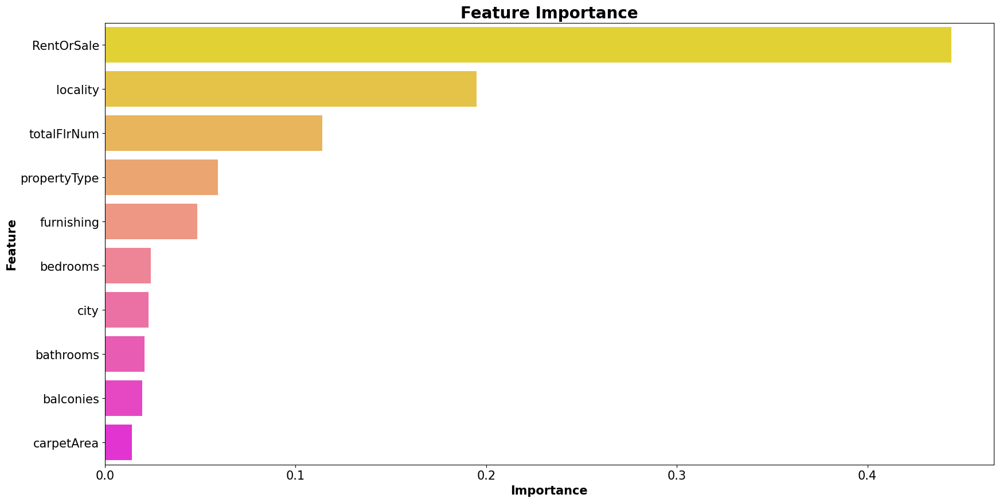

In [ ]:
from sklearn.metrics import mean_absolute_error,r2_score,classification_report

fi = pd.DataFrame(rfr.feature_importances_,
             columns=['importance'])
fi['feature'] = scaling_feature
fi = fi.sort_values('importance', ascending=False)

top_10_features = fi.head(10)

plt.figure(figsize=(20, 10))
ax = sns.barplot(data=top_10_features, x='importance', y='feature',
                 palette="spring_r")
ax.tick_params(axis='both', which='both', labelsize=15)
ax.set_xlabel('Importance',fontsize=15, weight="bold")
ax.set_ylabel('Feature',fontsize=15,weight="bold")
plt.title("Feature Importance", size=20, weight="bold")

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Assuming dataset is already loaded in 'dataset'
dataset = pd.read_csv('Scraped_Data.csv')
# 1. Identify categorical columns (you can use `df.select_dtypes` to check which columns are of type 'object')
categorical_columns = dataset.select_dtypes(include=['object']).columns

# 2. Apply One-Hot Encoding to categorical features
dataset_encoded = pd.get_dummies(dataset, columns=categorical_columns, drop_first=True)

# 3. Split the data into train and test (keeping 'exactPrice' as the target)
train_data = dataset_encoded[dataset_encoded['exactPrice'].notnull()]
test_data = dataset_encoded[dataset_encoded['exactPrice'].isnull()]

X_train = train_data.drop(columns=['exactPrice'])
y_train = train_data['exactPrice']
X_test = test_data.drop(columns=['exactPrice'])

# 4. Train the model (RandomForestRegressor or any other model you've chosen)
model = RandomForestRegressor(n_estimators=1000, random_state=42)
model.fit(X_train, y_train)  # Fit the model on the data with known 'exactPrice'

# 5. Make predictions for the test data (houses with missing 'exactPrice')
predicted_prices = model.predict(X_test)

# 6. Insert the predicted prices back into the test_data dataframe
test_data['predictedPrice'] = predicted_prices

# 7. Combine the predicted data with the original data (optional)
final_predictions = pd.concat([train_data, test_data])

# 8. Print or examine the predictions
print(final_predictions[['predictedPrice']].head())

